<a href="https://colab.research.google.com/github/jtndr26/News-Prediction/blob/main/Online_News_Popularity_Prediction_Jeetendra_Sarpe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Problem Description

The consumption of online news is expediting day by day due to the extensive adoption of smartphones and the rise of social networks. Online news content includes various key properties like it is easily produced, it is small in size, its lifespan is short and the cost is low. Such qualities make news content more effective to be consumed on social sharing platforms. More interestingly, such content can capture the eye of a signiﬁcant amount of internet users within a brief period of time. As a result, the main target on the analysis of online news content, like predicting the recognition of story articles and demonstrating their decay of interest over time, has significantly increased since it has so many practical meanings.

### Github Link:
https://github.com/jtndr26/News-Prediction/blob/main/Online_News_Popularity_Prediction_Jeetendra_Sarpe.ipynb

**Data Description:**

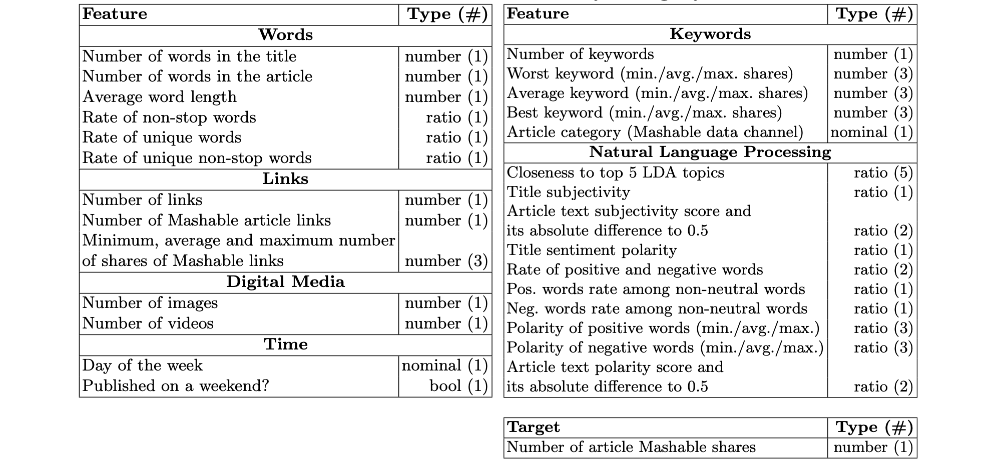

Data dictionary:
https://drive.google.com/file/d/1hb5aoKteX25tDh5NQpW_Vx7uw6VetFIi/view?usp=sharing



## 1. Read and Understand Data

In [ ]:
# Importing required Libraries
import numpy as np, pandas as pd
import matplotlib.pyplot as plt, seaborn as sns
%matplotlib inline
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [ ]:
# Supressing Warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

In [ ]:
path = '/content/drive/My Drive/Feynn_Labs/News/'
news = pd.read_csv(path+'train.csv')
news.head()

,id,url,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,0,http://mashable.com/2013/03/15/build-arduino-p...,8.0,211.0,0.629808,1.0,0.800000,6.0,3.0,0.0,0.0,4.606635,8.0,0.0,0.0,0.0,0.0,1.0,0.0,217.0,2300.0,797.714286,0.0,617900.0,115912.500000,0.000000,5103.042553,2568.648709,2000.0,2000.0,2000.00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.025025,0.025047,0.025012,0.025377,0.899540,0.647421,0.182837,0.033175,0.004739,0.875000,0.125000,0.413435,0.100000,0.6,-0.100000,NaN,-0.100000,1.000000,0.600000,0.500000,0.600000,36700
1,1,http://mashable.com/2013/09/04/edible-bar-codes/,12.0,416.0,0.603535,1.0,0.663580,22.0,7.0,1.0,16.0,5.004808,7.0,0.0,1.0,0.0,0.0,0.0,0.0,4.0,768.0,259.400000,0.0,NaN,169071.428571,0.000000,3339.790199,2112.665837,658.0,13700.0,4477.25,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0,0.170984,0.029080,0.028572,0.742792,0.028572,0.449248,0.148915,0.038462,NaN,0.800000,0.200000,0.324716,0.033333,1.0,-0.228621,-0.5000,-0.071429,0.000000,0.000000,0.500000,0.000000,24200
2,2,http://mashable.com/2014/06/20/non-player-char...,7.0,229.0,0.638393,1.0,0.746479,9.0,4.0,1.0,1.0,4.829694,8.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,1100.0,472.625000,4800.0,843300.0,204837.500000,1575.400000,3562.101631,2589.125480,4800.0,NaN,4800.00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.025046,0.025041,0.025001,0.025000,0.899912,0.353209,0.116600,0.034934,0.021834,NaN,0.384615,0.354545,0.050000,1.0,-0.260833,-0.5000,-0.166667,0.000000,0.000000,0.500000,0.000000,945
3,3,http://mashable.com/2014/08/06/food-art-vine-c...,9.0,473.0,0.542373,1.0,0.752809,7.0,0.0,1.0,1.0,4.634249,7.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,447.0,150.400000,0.0,843300.0,229728.571429,0.000000,3504.933802,NaN,0.0,0.0,0.00,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0,0.028580,0.028581,0.028577,0.166853,0.747408,0.548957,0.254370,0.065539,0.010571,0.861111,0.138889,0.356253,0.136364,0.7,-0.167500,-0.2500,-0.100000,0.000000,0.000000,0.500000,0.000000,844
4,4,http://mashable.com/2014/12/17/blackberry-clas...,13.0,1097.0,0.505213,1.0,0.676343,10.0,4.0,14.0,0.0,4.678213,4.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.0,1200.0,299.250000,33100.0,843300.0,381925.000000,2822.635182,5418.750000,3668.285640,1400.0,2300.0,2000.00,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.050004,0.052276,0.050148,0.797536,0.050036,0.436525,0.156793,0.041021,0.010027,0.803571,0.196429,0.366255,0.033333,1.0,-0.193182,-0.3125,-0.100000,0.383333,0.166667,0.116667,0.166667,551


In [ ]:
news.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29733 entries, 0 to 29732
Data columns (total 61 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             29733 non-null  int64  
 1   url                            29733 non-null  object 
 2   n_tokens_title                 29733 non-null  float64
 3   n_tokens_content               29733 non-null  float64
 4   n_unique_tokens                29733 non-null  float64
 5   n_non_stop_words               29733 non-null  float64
 6   n_non_stop_unique_tokens       29733 non-null  float64
 7   num_hrefs                      28921 non-null  float64
 8   num_self_hrefs                 25200 non-null  float64
 9   num_imgs                       24326 non-null  float64
 10  num_videos                     29146 non-null  float64
 11  average_token_length           29733 non-null  float64
 12  num_keywords                   29269 non-null 

## 2. Manipulating the Dataset

In [ ]:
round(100*news.isnull().sum()/news.shape[0],2)

id                                0.00
url                               0.00
n_tokens_title                    0.00
n_tokens_content                  0.00
n_unique_tokens                   0.00
n_non_stop_words                  0.00
n_non_stop_unique_tokens          0.00
num_hrefs                         2.73
num_self_hrefs                   15.25
num_imgs                         18.19
num_videos                        1.97
average_token_length              0.00
num_keywords                      1.56
data_channel_is_lifestyle         0.00
data_channel_is_entertainment     0.00
data_channel_is_bus               0.00
data_channel_is_socmed            0.00
data_channel_is_tech              0.00
data_channel_is_world             0.00
kw_min_min                        3.65
kw_max_min                        1.53
kw_avg_min                        0.28
kw_min_max                        0.46
kw_max_max                        5.10
kw_avg_max                        0.39
kw_min_avg               

In [ ]:
news.shape

(29733, 61)

In [ ]:
news.url

0        http://mashable.com/2013/03/15/build-arduino-p...
1         http://mashable.com/2013/09/04/edible-bar-codes/
2        http://mashable.com/2014/06/20/non-player-char...
3        http://mashable.com/2014/08/06/food-art-vine-c...
4        http://mashable.com/2014/12/17/blackberry-clas...
5        http://mashable.com/2013/09/09/apple-iphone-ev...
6                  http://mashable.com/2013/05/03/dabkick/
7        http://mashable.com/2014/05/18/tech-startup-jobs/
8        http://mashable.com/2013/11/25/twitter-stock-n...
9        http://mashable.com/2014/10/30/jake-gyllenhaal...
10       http://mashable.com/2013/02/20/starbucks-video...
11        http://mashable.com/2013/08/08/off-page-project/
12       http://mashable.com/2014/12/02/uberpool-new-york/
13       http://mashable.com/2014/09/14/american-man-no...
14       http://mashable.com/2014/06/05/why-texting-is-...
15       http://mashable.com/2014/08/15/ask-a-dev-andro...
16       http://mashable.com/2014/07/29/higher-costs-to.

In [ ]:
# Description about the variables
data_dict = pd.read_csv('data_dictionary.csv')
data_dict

,Unnamed: 0,column,description
0,0,url,URL of the article (non-predictive)
1,1,timedelta,Days between the article publication and the d...
2,2,ntokenstitle,Number of words in the title
3,3,ntokenscontent,Number of words in the content
4,4,nuniquetokens,Rate of unique words in the content
5,5,nnonstop_words,Rate of non-stop words in the content
6,6,nnonstopuniquetokens,Rate of unique non-stop words in the content
7,7,num_hrefs,Number of links
8,8,numselfhrefs,Number of links to other articles published by...
9,9,num_imgs,Number of images


The url variables is non-predictive as described in the dictionary and also the only object type data in the data set. As the url variable is a web link for an article we're dropping this feature.

In [ ]:
news.drop('url',axis = 1,inplace = True)
news.shape

(29733, 60)

We've already checked that the null values are less than 35% in the data set and all the variables are of numerical type. Hence we impute the missing values by the median for continuous variables and with mode for categorical.

In [ ]:
news.nunique()

id                               29733
n_tokens_title                      20
n_tokens_content                  2250
n_unique_tokens                  21820
n_non_stop_words                  1404
n_non_stop_unique_tokens         18703
num_hrefs                          124
num_self_hrefs                      55
num_imgs                            86
num_videos                          52
average_token_length             23555
num_keywords                        10
data_channel_is_lifestyle            2
data_channel_is_entertainment        2
data_channel_is_bus                  2
data_channel_is_socmed               2
data_channel_is_tech                 2
data_channel_is_world                2
kw_min_min                          23
kw_max_min                        1038
kw_avg_min                       14367
kw_min_max                         957
kw_max_max                          30
kw_avg_max                       24057
kw_min_avg                       12615
kw_max_avg               

In [ ]:
# Categorical Features
cat_vars = []
for i in news.columns:
    if news[i].nunique() <3:
        cat_vars.append(i)
cat_vars

['data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_bus',
 'data_channel_is_socmed',
 'data_channel_is_tech',
 'data_channel_is_world',
 'weekday_is_monday',
 'weekday_is_tuesday',
 'weekday_is_wednesday',
 'weekday_is_thursday',
 'weekday_is_friday',
 'weekday_is_saturday',
 'weekday_is_sunday',
 'is_weekend']

In [ ]:
news[cat_vars].head()

,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [ ]:
for i in news[cat_vars].columns:
    if news[i].isnull().sum()!=0:
        I = news[i].mode()
        news[i] = news[i].fillna(value = I.iloc[0])
news[cat_vars].isnull().sum()

data_channel_is_lifestyle        0
data_channel_is_entertainment    0
data_channel_is_bus              0
data_channel_is_socmed           0
data_channel_is_tech             0
data_channel_is_world            0
weekday_is_monday                0
weekday_is_tuesday               0
weekday_is_wednesday             0
weekday_is_thursday              0
weekday_is_friday                0
weekday_is_saturday              0
weekday_is_sunday                0
is_weekend                       0
dtype: int64

In [ ]:
news.isnull().sum()

id                                  0
n_tokens_title                      0
n_tokens_content                    0
n_unique_tokens                     0
n_non_stop_words                    0
n_non_stop_unique_tokens            0
num_hrefs                         812
num_self_hrefs                   4533
num_imgs                         5407
num_videos                        587
average_token_length                0
num_keywords                      464
data_channel_is_lifestyle           0
data_channel_is_entertainment       0
data_channel_is_bus                 0
data_channel_is_socmed              0
data_channel_is_tech                0
data_channel_is_world               0
kw_min_min                       1084
kw_max_min                        456
kw_avg_min                         84
kw_min_max                        137
kw_max_max                       1515
kw_avg_max                        117
kw_min_avg                        305
kw_max_avg                        681
kw_avg_avg  

In [ ]:
# Now only the missing values in the numerical variables are needed to be handled.
for i in news.columns:
    if news[i].isnull().sum()!=0:
        I = news[i].median()
        news[i] = news[i].fillna(value = I)


In [ ]:
round(100*news.isnull().sum()/news.shape[0],2)

id                               0.0
n_tokens_title                   0.0
n_tokens_content                 0.0
n_unique_tokens                  0.0
n_non_stop_words                 0.0
n_non_stop_unique_tokens         0.0
num_hrefs                        0.0
num_self_hrefs                   0.0
num_imgs                         0.0
num_videos                       0.0
average_token_length             0.0
num_keywords                     0.0
data_channel_is_lifestyle        0.0
data_channel_is_entertainment    0.0
data_channel_is_bus              0.0
data_channel_is_socmed           0.0
data_channel_is_tech             0.0
data_channel_is_world            0.0
kw_min_min                       0.0
kw_max_min                       0.0
kw_avg_min                       0.0
kw_min_max                       0.0
kw_max_max                       0.0
kw_avg_max                       0.0
kw_min_avg                       0.0
kw_max_avg                       0.0
kw_avg_avg                       0.0
s

In [ ]:
news.describe()

,id,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000,29733.000000
mean,14866.000000,10.403861,545.376652,0.554071,1.004238,0.694586,10.761107,3.241886,3.873978,1.238422,4.542961,7.214576,0.052669,0.175327,0.158275,0.058386,0.185047,0.213870,24.857566,1147.165875,310.910576,13597.217603,758038.122625,259846.940887,1120.633387,5628.964959,3132.329635,3922.942714,10013.249513,6380.027764,0.162345,0.182054,0.177715,0.182222,0.138802,0.061716,0.064676,0.120304,0.185391,0.140411,0.217210,0.223688,0.233266,0.443912,0.118949,0.039537,0.016553,0.681935,0.287768,0.353398,0.095701,0.755331,-0.259021,-0.520649,-0.106828,0.281479,0.070498,0.346652,0.148002,3439.840581
std,8583.322113,2.122101,471.476136,4.064623,6.039790,3.768884,11.246014,3.547360,7.660364,4.120963,0.855936,1.897471,0.223375,0.380253,0.365005,0.234476,0.388342,0.410043,68.227016,3978.203798,623.074986,57737.027508,208601.152754,134952.241342,1130.850597,6027.230767,1302.764651,18683.426024,40337.716326,23579.622101,0.368773,0.385895,0.382279,0.386034,0.345746,0.240643,0.245957,0.325322,0.264106,0.218503,0.283237,0.295239,0.288963,0.112928,0.096383,0.017207,0.010623,0.189391,0.154595,0.103015,0.071163,0.247890,0.127682,0.287356,0.094097,0.323690,0.263945,0.187734,0.223024,12212.123341
min,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.393750,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,7433.000000,9.000000,245.000000,0.471376,1.000000,0.626598,4.000000,1.000000,1.000000,0.000000,4.477124,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,450.000000,141.323750,0.000000,843300.000000,173560.000000,0.000000,3571.268128,2404.661584,642.000000,1100.000000,992.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.025060,0.025013,0.028571,0.028571,0.0285

The data set is now does not have any missing values and the data types of the features are in suitable form.

## Detecting Outliers

Outliers can be easily detected using Boxplot

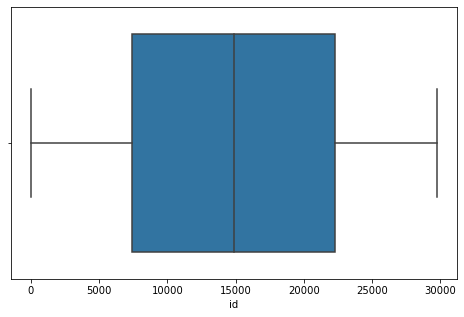

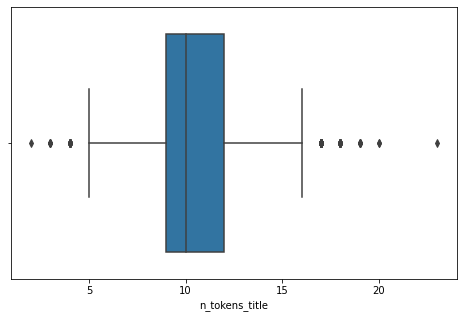

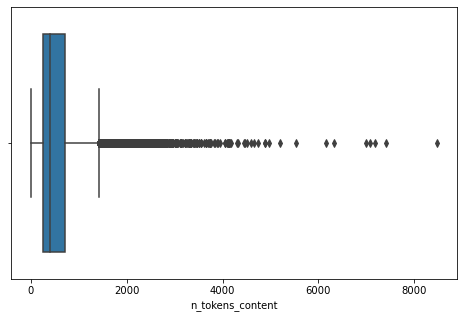

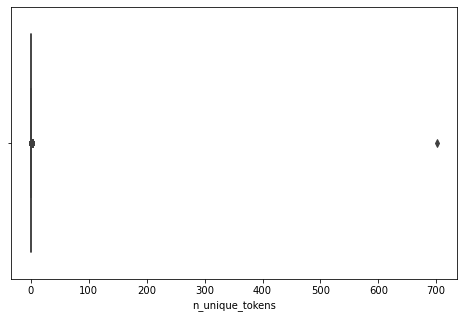

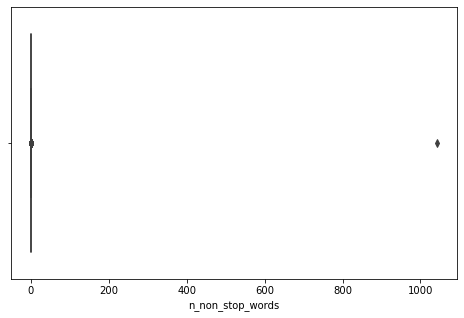

...

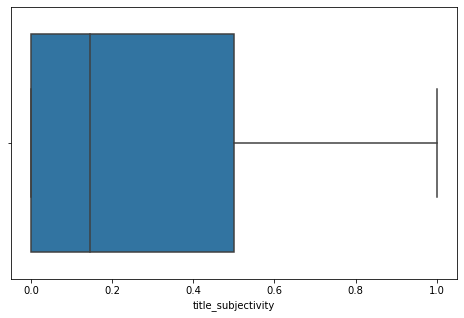

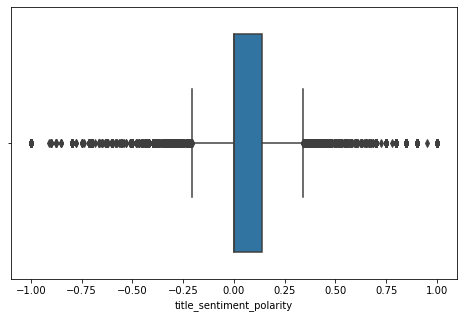

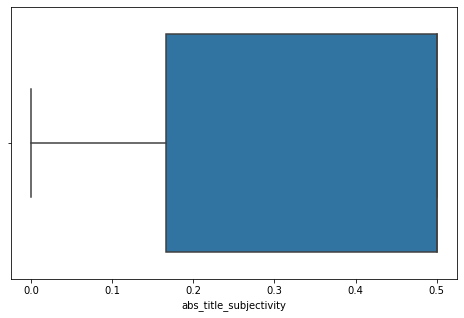

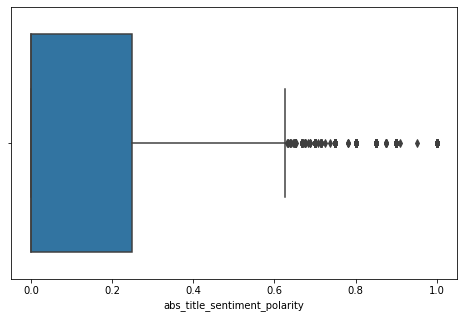

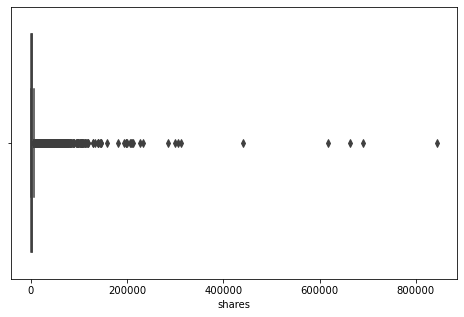

In [ ]:
for i in news.columns:
    plt.figure(figsize = [8,5])
    sns.boxplot(news[i])
    plt.show()

By looking at the boxplots of the predictor variables it is observed there are strong outliers that are needed to handled

## Removing Outliers

In [ ]:
Q1 = news.quantile(0.25)
Q3 = news.quantile(0.75)
IQR = Q3-Q1
print(IQR)

id                               1.486600e+04
n_tokens_title                   3.000000e+00
n_tokens_content                 4.690000e+02
n_unique_tokens                  1.376771e-01
n_non_stop_words                 4.353000e-09
n_non_stop_unique_tokens         1.279470e-01
num_hrefs                        9.000000e+00
num_self_hrefs                   3.000000e+00
num_imgs                         1.000000e+00
num_videos                       1.000000e+00
average_token_length             3.774213e-01
num_keywords                     3.000000e+00
data_channel_is_lifestyle        0.000000e+00
data_channel_is_entertainment    0.000000e+00
data_channel_is_bus              0.000000e+00
data_channel_is_socmed           0.000000e+00
data_channel_is_tech             0.000000e+00
data_channel_is_world            0.000000e+00
kw_min_min                       5.000000e+00
kw_max_min                       5.500000e+02
kw_avg_min                       2.132763e+02
kw_min_max                       7

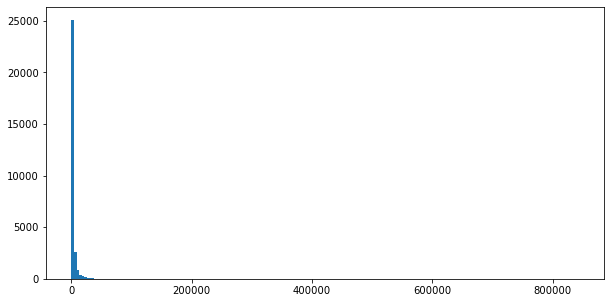

In [ ]:
plt.figure(figsize = [10,5])
plt.hist(news.shares,bins = 200)
plt.show()

- Plotting the 'shares' label in a histogram makes it clear that outliers are present! Anything beyond 3000 shares is not even visible! Let's remove them before moving further.
- We remove the outliers using a function, which leaves out the 'shares' where the value is larger than its mean +/- twice standard deviations.

In [ ]:
def rej_out(shares):
    u = np.median(news['shares'])
    s = np.std(news['shares'])
    filtered = [e for e in (news['shares']) if (u-2*s <e< u+2*s)]
    return filtered

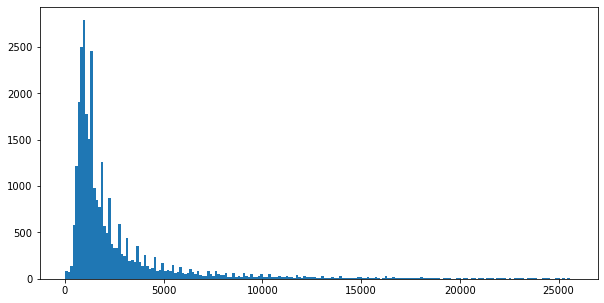

In [ ]:
filtered = rej_out('shares')
plt.figure(figsize = [10,5])
plt.hist(filtered,200)
plt.show()

In [ ]:
news.shape

(29733, 60)

In [ ]:
olnews = pd.DataFrame(filtered)
olnews.shape

(29328, 1)

Let's update the **news** dataframe,where outliers are rejected. We define an outlier as a value of 'shares' which is outside two standard deviations (= 1400 + (2 x 12212) = 25824) of the median for 'shares (1400). For this we use Pandas' Conditional Selection.
We obviously consider only the upper bound, which is a positive number. The mean minus two standard deviations would result in a negative number, and it's not possible to have a negative number of 'shares'.

In [ ]:
news = news[news['shares']<25824]
news.shape

(29328, 60)

As we see around 400 entried which were outliers are dropped.

In [ ]:
news.drop('id',axis = 1,inplace = True)

In [ ]:
news.describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,29328.000000,29328.000000,29328.000000,29328.00000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.00000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000,29328.000000
mean,10.399107,545.722347,0.554238,1.00491,0.694979,10.702605,3.246761,3.844722,1.228894,4.544148,7.211163,0.052680,0.175191,0.158858,0.058681,0.186273,0.215528,24.921543,1139.417751,309.787964,13544.239191,757773.602019,259117.727549,1116.649951,5594.235801,3118.844184,3866.012300,9896.263665,6290.536640,0.161791,0.182385,0.17768,0.182385,0.138809,0.061613,0.064750,0.120192,0.185906,0.140423,0.218603,0.220725,0.234309,0.443461,0.118994,0.039541,0.016531,0.682271,0.287624,0.353132,0.095596,0.755085,-0.258431,-0.519827,-0.106600,0.280502,0.070309,0.346748,0.147488,2601.850927
std,2.120082,470.282301,4.092547,6.08130,3.794755,11.133593,3.555949,7.627550,4.116035,0.853679,1.899379,0.223398,0.380137,0.365550,0.235031,0.389333,0.411195,68.301402,3912.086296,611.001073,57781.859429,208814.376189,134603.863606,1127.002937,5960.411690,1285.460940,18632.567157,40209.197698,23533.333789,0.368265,0.386168,0.38225,0.386168,0.345753,0.240456,0.246089,0.325192,0.264531,0.218545,0.284092,0.293503,0.289440,0.112668,0.096060,0.017192,0.010560,0.189101,0.154454,0.102757,0.070972,0.247802,0.127298,0.286997,0.093709,0.323200,0.263112,0.187799,0.222477,3320.322743
min,2.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.393750,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,9.000000,246.000000,0.471302,1.00000,0.626812,4.000000,1.000000,1.000000,0.000000,4.477537,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,450.000000,141.333333,0.000000,843300.000000,173300.000000,0.000000,3569.217787,2400.919894,639.000000,1100.000000,986.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.025061,0.025013,0.028572,0.028571,0.028574,0.401238,0.058651,0.028702,0.009804,0.600000,0.187500,0.307640,0.050000

## 3. EDA

In [ ]:
news.head()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
1,12.0,416.0,0.603535,1.0,0.663580,22.0,7.0,1.0,16.0,5.004808,7.0,0.0,1.0,0.0,0.0,0.0,0.0,4.0,768.0,259.400000,0.0,843300.0,169071.428571,0.000000,3339.790199,2112.665837,658.0,13700.0,4477.250000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.170984,0.029080,0.028572,0.742792,0.028572,0.449248,0.148915,0.038462,0.015358,0.800000,0.200000,0.324716,0.033333,1.0,-0.228621,-0.5000,-0.071429,0.000000,0.000000,0.500000,0.000000,24200
2,7.0,229.0,0.638393,1.0,0.746479,9.0,4.0,1.0,1.0,4.829694,8.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,1100.0,472.625000,4800.0,843300.0,204837.500000,1575.400000,3562.101631,2589.125480,4800.0,2900.0,4800.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.025046,0.025041,0.025001,0.025000,0.899912,0.353209,0.116600,0.034934,0.021834,0.709677,0.384615,0.354545,0.050000,1.0,-0.260833,-0.5000,-0.166667,0.000000,0.000000,0.500000,0.000000,945
3,9.0,473.0,0.542373,1.0,0.752809,7.0,0.0,1.0,1.0,4.634249,7.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,447.0,150.400000,0.0,843300.0,229728.571429,0.000000,3504.933802,2873.400669,0.0,0.0,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.028580,0.028581,0.028577,0.166853,0.747408,0.548957,0.254370,0.065539,0.010571,0.861111,0.138889,0.356253,0.136364,0.7,-0.167500,-0.2500,-0.100000,0.000000,0.000000,0.500000,0.000000,844
4,13.0,1097.0,0.505213,1.0,0.676343,10.0,4.0,14.0,0.0,4.678213,4.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.0,1200.0,299.250000,33100.0,843300.0,381925.000000,2822.635182,5418.750000,3668.285640,1400.0,2300.0,2000.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.050004,0.052276,0.050148,0.797536,0.050036,0.436525,0.156793,0.041021,0.010027,0.803571,0.196429,0.366255,0.033333,1.0,-0.193182,-0.3125,-0.100000,0.383333,0.166667,0.116667,0.166667,551
5,11.0,175.0,0.705202,1.0,0.785714,8.0,3.0,1.0,1.0,4.834286,9.0,0.0,1.0,0.0,0.0,0.0,0.0,4.0,506.0,119.714286,0.0,843300.0,247744.444444,0.000000,8709.769231,3172.079106,4200.0,13300.0,9166.666667,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.022436,0.022608,0.022413,0.686423,0.246121,0.566667,0.061905,0.022857,0.017143,0.571429,0.428571,0.325000,0.100000,0.6,-0.422222,-0.6000,-0.166667,0.000000,0.000000,0.500000,0.000000,1000


In [ ]:
news[cat_vars].head()

,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


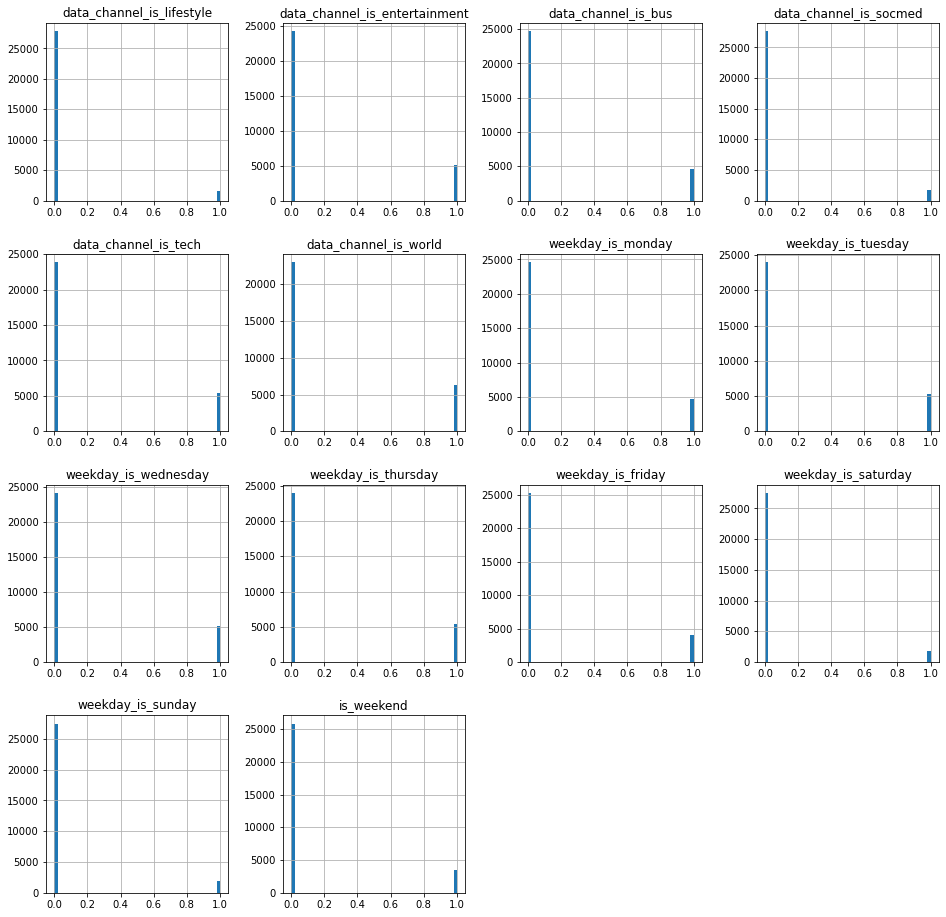

In [ ]:
news[cat_vars].hist(bins = 50,figsize = [16,16])
plt.show()

In [ ]:
wd = news[cat_vars].columns[6:13]
wd

Index(['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday',
       'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday',
       'weekday_is_sunday'],
      dtype='object')

In [ ]:
# Popular & Unpopular Shares w.r.t. mean and median
a,b = news['shares'].mean(),news['shares'].median()
print(f'Mean article shares = {a}')
print(f'Median article shares = {b}')

Mean article shares = 2601.850927441353
Median article shares = 1400.0


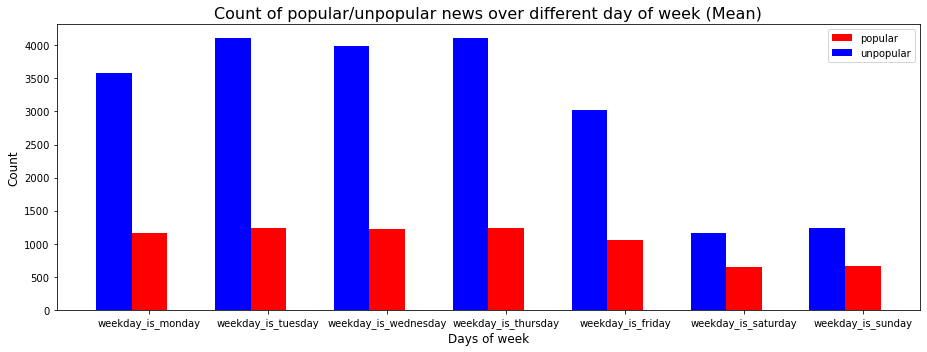

In [ ]:
pop_a = news[news['shares']>=a]
unpop_a = news[news['shares']<a]
pop_day_a = pop_a[wd].sum().values
unpop_day_a = unpop_a[wd].sum().values

fig = plt.figure(figsize = (13,5))
plt.title("Count of popular/unpopular news over different day of week (Mean)", fontsize = 16)
plt.bar(np.arange(len(wd)), pop_day_a, width = 0.3, align="center", color = 'r', \
          label = "popular")
plt.bar(np.arange(len(wd)) - 0.3, unpop_day_a, width = 0.3, align = "center", color = 'b', \
          label = "unpopular")
plt.xticks(np.arange(len(wd)), wd)
plt.ylabel("Count", fontsize = 12)
plt.xlabel("Days of week", fontsize = 12)

plt.legend(loc = 'upper right')
plt.tight_layout()
plt.show()

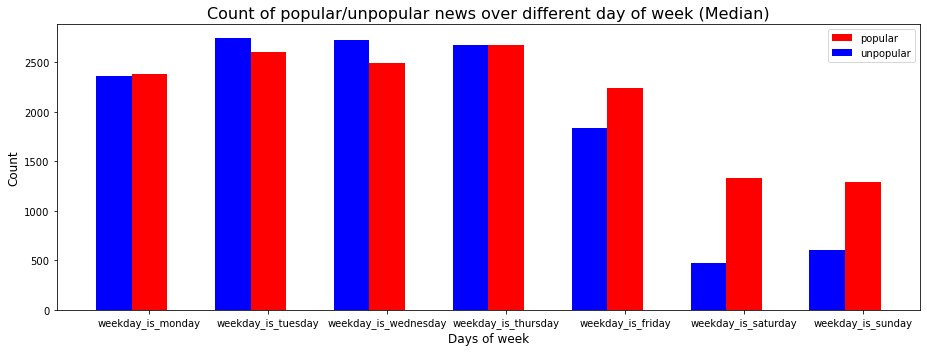

In [ ]:
pop_b = news[news['shares']>=b]
unpop_b = news[news['shares']<b]
pop_day_b = pop_b[wd].sum().values
unpop_day_b = unpop_b[wd].sum().values

fig = plt.figure(figsize = (13,5))
plt.title("Count of popular/unpopular news over different day of week (Median)", fontsize = 16)
plt.bar(np.arange(len(wd)), pop_day_b, width = 0.3, align="center", color = 'r', \
          label = "popular")
plt.bar(np.arange(len(wd)) - 0.3, unpop_day_b, width = 0.3, align = "center", color = 'b', \
          label = "unpopular")
plt.xticks(np.arange(len(wd)), wd)
plt.ylabel("Count", fontsize = 12)
plt.xlabel("Days of week", fontsize = 12)

plt.legend(loc = 'upper right')
plt.tight_layout()
plt.show()

In [ ]:
dc = news[cat_vars].columns[0:5]
dc

Index(['data_channel_is_lifestyle', 'data_channel_is_entertainment',
       'data_channel_is_bus', 'data_channel_is_socmed',
       'data_channel_is_tech'],
      dtype='object')

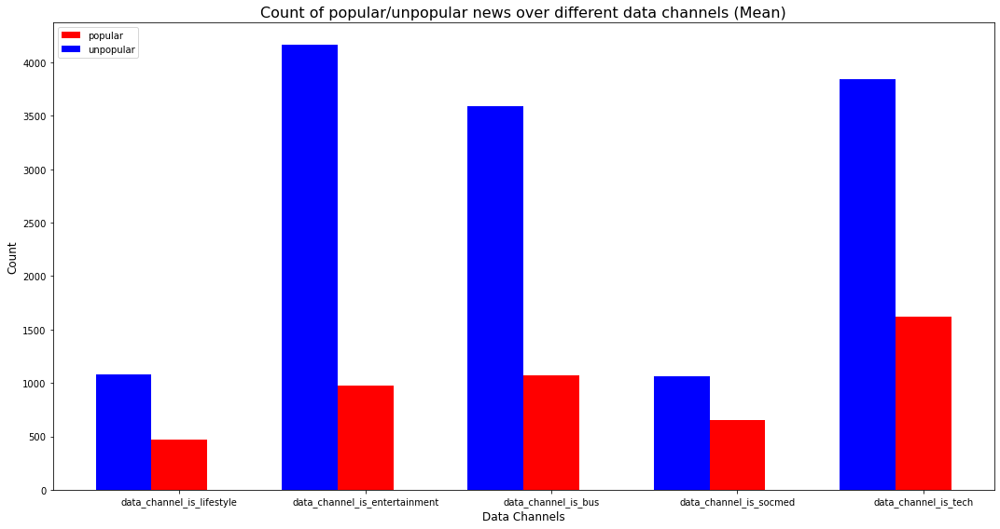

In [ ]:
pop_a = news[news['shares']>=a]
unpop_a = news[news['shares']<a]
pop_dc_a = pop_a[dc].sum().values
unpop_dc_a = unpop_a[dc].sum().values

fig = plt.figure(figsize = (15,8))
plt.title("Count of popular/unpopular news over different data channels (Mean)", fontsize = 16)
plt.bar(np.arange(len(dc)), pop_dc_a, width = 0.3, align="center", color = 'r', \
          label = "popular")
plt.bar(np.arange(len(dc)) - 0.3, unpop_dc_a, width = 0.3, align = "center", color = 'b', \
          label = "unpopular")
plt.xticks(np.arange(len(dc)), dc)
plt.ylabel("Count", fontsize = 12)
plt.xlabel("Data Channels", fontsize = 12)

plt.legend(loc = 'upper left')
plt.tight_layout()
plt.show()

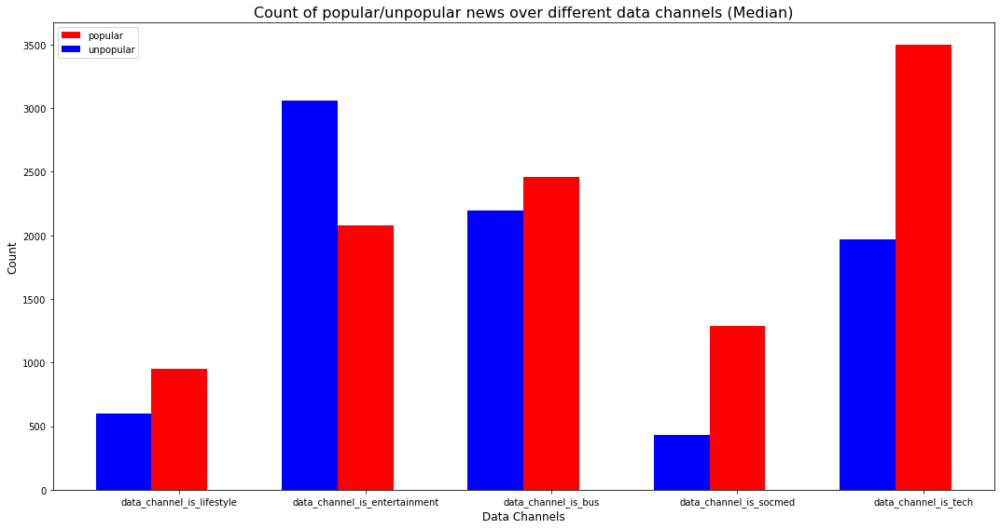

In [ ]:
pop_b = news[news['shares']>=b]
unpop_b = news[news['shares']<b]
pop_dc_b = pop_b[dc].sum().values
unpop_dc_b = unpop_b[dc].sum().values

fig = plt.figure(figsize = (15,8))
plt.title("Count of popular/unpopular news over different data channels (Median)", fontsize = 16)
plt.bar(np.arange(len(dc)), pop_dc_b, width = 0.3, align="center", color = 'r', \
          label = "popular")
plt.bar(np.arange(len(dc)) - 0.3, unpop_dc_b, width = 0.3, align = "center", color = 'b', \
          label = "unpopular")
plt.xticks(np.arange(len(dc)), dc)
plt.ylabel("Count", fontsize = 12)
plt.xlabel("Data Channels", fontsize = 12)

plt.legend(loc = 'upper left')
plt.tight_layout()
plt.show()

### Correlation in data Numerically and Graphically

In [ ]:
corrmat = news.corr()
corrmat['shares'].sort_values(ascending = False)

shares                           1.000000
kw_avg_avg                       0.183942
LDA_03                           0.121297
kw_max_avg                       0.096434
kw_min_avg                       0.085418
num_hrefs                        0.075125
self_reference_avg_sharess       0.070577
num_imgs                         0.068193
self_reference_min_shares        0.066674
is_weekend                       0.062075
self_reference_max_shares        0.055484
abs_title_sentiment_polarity     0.055020
title_subjectivity               0.049476
global_subjectivity              0.049300
kw_avg_max                       0.048760
data_channel_is_socmed           0.046893
num_keywords                     0.044774
title_sentiment_polarity         0.044016
weekday_is_sunday                0.042656
weekday_is_saturday              0.040448
kw_avg_min                       0.038129
kw_max_min                       0.032804
num_videos                       0.032611
data_channel_is_lifestyle        0

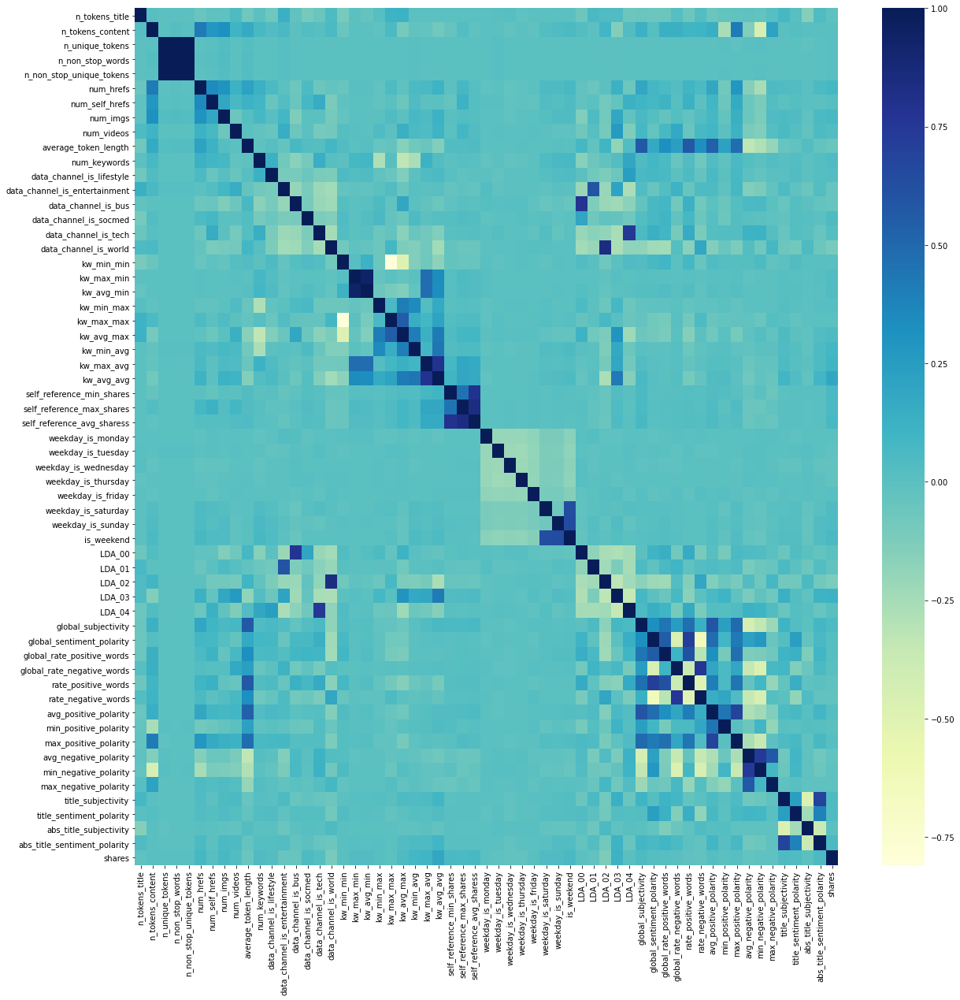

In [ ]:
plt.figure(figsize = [20,20])
sns.heatmap(corrmat,vmax = True,cmap="YlGnBu")
plt.show()

In [ ]:
# Top 15 most correlated features
top15 = corrmat['shares'].sort_values(ascending = False)[1:16]
top15

kw_avg_avg                      0.183942
LDA_03                          0.121297
kw_max_avg                      0.096434
kw_min_avg                      0.085418
num_hrefs                       0.075125
self_reference_avg_sharess      0.070577
num_imgs                        0.068193
self_reference_min_shares       0.066674
is_weekend                      0.062075
self_reference_max_shares       0.055484
abs_title_sentiment_polarity    0.055020
title_subjectivity              0.049476
global_subjectivity             0.049300
kw_avg_max                      0.048760
data_channel_is_socmed          0.046893
Name: shares, dtype: float64

From the graphical representation along with the description about the correlation between variables, the features are not highly correlated. Hence we'll be considering all the variable for further analysis.

## 4. Train Test Split

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
df_train,df_test = train_test_split(news,train_size = 0.7, random_state = 42)

## 5. Scaling Train Dataset

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

In [ ]:
num_vars = []
for i in news.columns:
    if news[i].nunique()>2:
        num_vars.append(i)
num_vars

['n_tokens_title',
 'n_tokens_content',
 'n_unique_tokens',
 'n_non_stop_words',
 'n_non_stop_unique_tokens',
 'num_hrefs',
 'num_self_hrefs',
 'num_imgs',
 'num_videos',
 'average_token_length',
 'num_keywords',
 'kw_min_min',
 'kw_max_min',
 'kw_avg_min',
 'kw_min_max',
 'kw_max_max',
 'kw_avg_max',
 'kw_min_avg',
 'kw_max_avg',
 'kw_avg_avg',
 'self_reference_min_shares',
 'self_reference_max_shares',
 'self_reference_avg_sharess',
 'LDA_00',
 'LDA_01',
 'LDA_02',
 'LDA_03',
 'LDA_04',
 'global_subjectivity',
 'global_sentiment_polarity',
 'global_rate_positive_words',
 'global_rate_negative_words',
 'rate_positive_words',
 'rate_negative_words',
 'avg_positive_polarity',
 'min_positive_polarity',
 'max_positive_polarity',
 'avg_negative_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_subjectivity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'abs_title_sentiment_polarity',
 'shares']

In [ ]:
df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])

In [ ]:
X_train = df_train.drop('shares',axis = 1)
y_train = df_train['shares']
X_test = df_test.drop('shares',axis = 1)
y_test = df_test['shares']

In [ ]:
X_train.head()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity
5414,0.20,0.077767,0.434597,1.0,0.574413,0.046784,0.025862,0.007812,0.000000,0.538177,1.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.016949,0.006702,0.013925,0.002253,1.000000,0.135195,0.274245,0.019705,0.069175,0.000964,0.000964,0.000964,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.642659,0.114469,0.002024,0.117504,0.124710,0.468660,0.672837,0.259267,0.055410,0.838710,0.161290,0.358636,0.100000,1.0,0.823333,0.708333,0.900,0.000000,0.500000,1.000000,0.00
20493,0.50,0.065612,0.505717,1.0,0.608696,0.134503,0.017241,0.039062,0.010989,0.627811,0.222222,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.167675,1.000000,0.501759,0.600080,0.011452,0.061165,0.000875,0.001304,0.001090,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.053351,0.053765,0.793001,0.053435,0.053346,0.361600,0.440230,0.141829,0.065675,0.705882,0.294118,0.274697,0.100000,1.0,0.718333,0.400000,0.900,0.333333,0.625000,0.333333,0.00
9288,0.45,0.040949,0.591483,1.0,0.711443,0.000000,0.000000,0.007812,0.000000,0.564791,0.555556,0.0,0.0,1.0,0.0,0.0,0.0,0.016949,0.002433,0.008016,0.002609,0.818688,0.285624,0.358510,0.011644,0.065953,0.000000,0.003439,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.431297,0.016803,0.205144,0.016698,0.332027,0.396232,0.451474,0.359819,0.112163,0.730769,0.269231,0.358636,0.136364,0.8,0.659524,0.400000,0.975,0.454545,0.568182,0.090909,0.00
11522,0.15,0.132995,0.396046,1.0,0.480744,0.005848,0.025862,0.164062,0.010989,0.617579,0.555556,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.001659,0.002195,0.001423,1.000000,0.441994,0.235453,0.011423,0.048598,0.000000,0.000000,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.016672,0.016802,0.940859,0.016699,0.016669,0.326699,0.345827,0.064140,0.142561,0.333333,0.666667,0.378099,0.050000,1.0,0.722222,0.200000,0.900,0.000000,0.500000,1.000000,0.00
9428,0.25,0.102313,0.415296,1.0,0.560166,0.029240,0.043103,0.117188,0.000000,0.519649,0.444444,0.0,0.0,0.0,0.0,1.0,0.0,0.016949,0.003070,0.008110,0.000000,0.818688,0.181074,0.000277,0.011075,0.034406,0.002372,0.005099,0.002609,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.024028,0.024218,0.024207,0.460875,0.467985,0.499200,0.575352,0.386555,0.117927,0.784615,0.215385,0.425310,0.100000,0.9,0.775893,0.500000,0.900,0.600000,0.575000,0.200000,0.15


In [ ]:
X_train.describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity
count,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000,20529.000000
mean,0.369343,0.064404,0.541462,0.969360,0.672951,0.062663,0.028091,0.030241,0.013425,0.565224,0.691769,0.052901,0.172634,0.159823,0.057723,0.188124,0.214672,0.088279,0.003869,0.007309,0.015904,0.898453,0.306877,0.310140,0.018817,0.071651,0.004591,0.011870,0.007502,0.162112,0.180769,0.176482,0.185299,0.137951,0.061377,0.065858,0.121779,0.184935,0.134454,0.222213,0.223281,0.238476,0.443467,0.482233,0.259468,0.120858,0.682423,0.287489,0.353007,0.095317,0.755246,0.741412,0.479286,0.893859,0.279448,0.535343,0.694124,0.147672
std,0.105650,0.055784,0.140735,0.172343,0.155176,0.063957,0.030747,0.060136,0.045136,0.106275,0.210994,0.223841,0.377940,0.366450,0.233225,0.390821,0.410605,0.231965,0.014203,0.015358,0.068073,0.247735,0.159433,0.311871,0.020866,0.030514,0.021670,0.048341,0.027672,0.368563,0.384836,0.381239,0.388549,0.344857,0.240026,0.248040,0.327038,0.291195,0.240357,0.314931,0.323622,0.319243,0.112596,0.092675,0.112121,0.077630,0.189158,0.154383,0.102986,0.070995,0.247921,0.126992,0.287127,0.092221,0.322923,0.131788,0.375875,0.223148
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.300000,0.029030,0.480947,1.000000,0.626250,0.023392,0.008621,0.007812,0.000000,0.556794,0.555556,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001511,0.003320,0.000000,1.000000,0.205127,0.000277,0.011960,0.055013,0.000758,0.001304,0.001173,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007561,0.007574,0.011521,0.009046,0.011431,0.400964,0.423828,0.188834,0.071598,0.600000,0.187500,0.307738,0.050000,0.600000,0.672727,0.300000,0.875000,0.000000,0.500000,0.333333,0.000000
50%,0.350000,0.048383,0.550484,1.000000,0.690987,0.040936,0.025862,0.007812,0.000000,0.580145,0.6

## 6. Model Building

## Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

In [ ]:
lm = LinearRegression()
lm = lm.fit(X_train,y_train)

In [ ]:
rfe = RFE(lm,20)
rfe = rfe.fit(X_train,y_train)

In [ ]:
list(zip(X_train.columns,rfe.support_,rfe.ranking_))

[('n_tokens_title', False, 39),
 ('n_tokens_content', False, 9),
 ('n_unique_tokens', False, 22),
 ('n_non_stop_words', False, 29),
 ('n_non_stop_unique_tokens', False, 38),
 ('num_hrefs', True, 1),
 ('num_self_hrefs', True, 1),
 ('num_imgs', True, 1),
 ('num_videos', False, 3),
 ('average_token_length', True, 1),
 ('num_keywords', False, 17),
 ('data_channel_is_lifestyle', False, 7),
 ('data_channel_is_entertainment', True, 1),
 ('data_channel_is_bus', True, 1),
 ('data_channel_is_socmed', False, 25),
 ('data_channel_is_tech', False, 26),
 ('data_channel_is_world', False, 14),
 ('kw_min_min', False, 18),
 ('kw_max_min', True, 1),
 ('kw_avg_min', False, 24),
 ('kw_min_max', False, 31),
 ('kw_max_max', False, 37),
 ('kw_avg_max', True, 1),
 ('kw_min_avg', False, 28),
 ('kw_max_avg', True, 1),
 ('kw_avg_avg', True, 1),
 ('self_reference_min_shares', True, 1),
 ('self_reference_max_shares', False, 2),
 ('self_reference_avg_sharess', True, 1),
 ('weekday_is_monday', False, 23),
 ('weekday_

In [ ]:
# We are interested in the columns/variables which listed by the RFE
col = X_train.columns[rfe.support_]
col

Index(['num_hrefs', 'num_self_hrefs', 'num_imgs', 'average_token_length',
       'data_channel_is_entertainment', 'data_channel_is_bus', 'kw_max_min',
       'kw_avg_max', 'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares',
       'self_reference_avg_sharess', 'LDA_00', 'LDA_01', 'LDA_02', 'LDA_03',
       'LDA_04', 'global_subjectivity', 'min_positive_polarity',
       'title_sentiment_polarity'],
      dtype='object')

In [ ]:
X_train_rfe = X_train[col]
X_train_rfe.head()

,num_hrefs,num_self_hrefs,num_imgs,average_token_length,data_channel_is_entertainment,data_channel_is_bus,kw_max_min,kw_avg_max,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_avg_sharess,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,min_positive_polarity,title_sentiment_polarity
5414,0.046784,0.025862,0.007812,0.538177,0.0,1.0,0.006702,0.135195,0.019705,0.069175,0.000964,0.000964,0.642659,0.114469,0.002024,0.117504,0.124710,0.468660,0.100000,0.500000
20493,0.134503,0.017241,0.039062,0.627811,0.0,0.0,0.000000,0.501759,0.011452,0.061165,0.000875,0.001090,0.053351,0.053765,0.793001,0.053435,0.053346,0.361600,0.100000,0.625000
9288,0.000000,0.000000,0.007812,0.564791,0.0,1.0,0.002433,0.285624,0.011644,0.065953,0.000000,0.000000,0.431297,0.016803,0.205144,0.016698,0.332027,0.396232,0.136364,0.568182
11522,0.005848,0.025862,0.164062,0.617579,0.0,0.0,0.001659,0.441994,0.011423,0.048598,0.000000,0.000000,0.016672,0.016802,0.940859,0.016699,0.016669,0.326699,0.050000,0.500000
9428,0.029240,0.043103,0.117188,0.519649,0.0,0.0,0.003070,0.181074,0.011075,0.034406,0.002372,0.002609,0.024028,0.024218,0.024207,0.460875,0.467985,0.499200,0.100000,0.575000


In [ ]:
# Building Model using statsmodelmethod
import statsmodels.api as sm
# Adding constant to X_train var
X_train_lm = sm.add_constant(X_train_rfe)

In [ ]:
lm = sm.OLS(y_train,X_train_lm).fit()
print(lm.summary())

                            OLS Regression Results                            
Dep. Variable:                 shares   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.060
Method:                 Least Squares   F-statistic:                     66.59
Date:                Wed, 08 Sep 2021   Prob (F-statistic):          2.65e-261
Time:                        22:55:12   Log-Likelihood:                 13627.
No. Observations:               20529   AIC:                        -2.721e+04
Df Residuals:                   20508   BIC:                        -2.705e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const         

In [ ]:
# Evaluating Model
y_train_pred = lm.predict(X_train_lm)

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score
import math

In [ ]:
mse = math.sqrt(mean_squared_error(y_train,y_train_pred))
print('Root mean sqaured error:',mse)
print('R2_score:',r2_score(y_train,y_train_pred))

Root mean sqaured error: 0.12459008406632897
R2_score: 0.06097941334218493


The above scores is acquired from a premature model, with further tunning and processes we'll get the score on a better model.

## Feature Engineering and Selection

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(random_state=100)
pca.fit_transform(X_train_rfe)

array([[ 8.33980516e-01,  5.13319423e-01, -6.94050330e-02, ...,
        -1.77931449e-03,  4.40324744e-03, -2.52802461e-13],
       [-4.82747943e-03, -3.72521508e-01,  5.63990208e-01, ...,
        -8.97725539e-05, -2.50583554e-03,  5.44721398e-14],
       [ 8.08299593e-01,  2.41717313e-01, -5.13187687e-02, ...,
        -2.02917048e-03,  7.46011571e-03,  1.43575523e-13],
       ...,
       [ 3.88242860e-03, -4.71947159e-01,  4.37642538e-01, ...,
         1.87987462e-03, -5.66895138e-03,  5.97348537e-16],
       [ 1.17533776e-02, -4.66730572e-01, -5.50372677e-01, ...,
         2.60494621e-04,  6.16919928e-04,  4.42657917e-14],
       [-1.98123815e-01, -8.03478167e-02, -2.05512496e-01, ...,
        -2.60314078e-03,  7.23807995e-03,  5.76849682e-14]])

In [ ]:
components = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1],'Feature':X_train_rfe.columns })
components

,PC1,PC2,Feature
0,-0.007613,0.000579,num_hrefs
1,-0.001945,-0.002667,num_self_hrefs
2,-0.022164,0.004918,num_imgs
3,0.025342,-0.013197,average_token_length
4,-0.517188,0.497583,data_channel_is_entertainment
5,0.602751,0.430462,data_channel_is_bus
6,-0.000116,-0.000127,kw_max_min
7,0.024086,0.093201,kw_avg_max
8,-0.002293,0.003720,kw_max_avg
9,-0.008106,0.012690,kw_avg_avg


In [ ]:
pca.explained_variance_ratio_

array([2.95183273e-01, 2.33306478e-01, 1.53946842e-01, 1.46527662e-01,
       4.40787007e-02, 3.38873963e-02, 2.62226394e-02, 2.19029200e-02,
       2.12695697e-02, 6.70791978e-03, 5.42822851e-03, 4.44823239e-03,
       3.09894002e-03, 1.50537331e-03, 1.11569464e-03, 9.44119651e-04,
       1.90933875e-04, 1.48594776e-04, 8.64823511e-05, 4.68260398e-26])

In [ ]:
var_cum = np.cumsum(pca.explained_variance_ratio_)
var_cum

array([0.29518327, 0.52848975, 0.68243659, 0.82896425, 0.87304296,
       0.90693035, 0.93315299, 0.95505591, 0.97632548, 0.9830334 ,
       0.98846163, 0.99290986, 0.9960088 , 0.99751417, 0.99862987,
       0.99957399, 0.99976492, 0.99991352, 1.        , 1.        ])

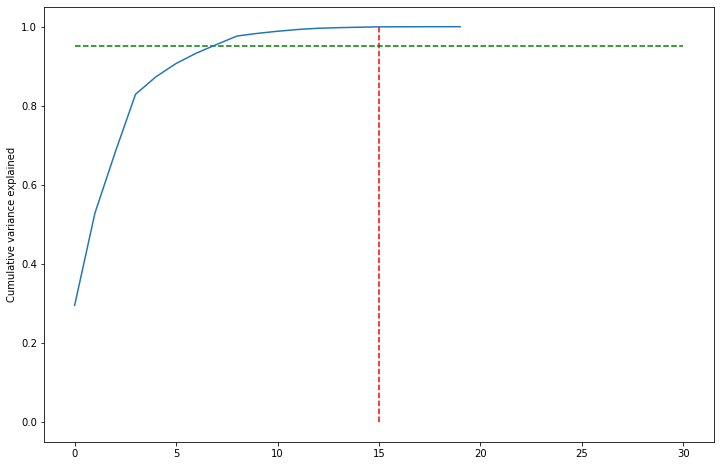

In [ ]:
fig = plt.figure(figsize=[12,8])
plt.vlines(x=15, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=30, xmin=0, colors="g", linestyles="--")
plt.plot(var_cum)
plt.ylabel("Cumulative variance explained")
plt.show()

From above plot we say, about 95% variance is explained by 15 variables.

In [ ]:
colnames = list(X_train_rfe.columns)
pca_df = pd.DataFrame({'PC1':pca.components_[0],'PC2':pca.components_[1],'PC3':pca.components_[2],
                       'PC4':pca.components_[3],'PC5':pca.components_[4],
                       'PC6':pca.components_[5],'PC7':pca.components_[6],'PC8':pca.components_[7],
                       'PC9':pca.components_[8],'PC10':pca.components_[9],'PC11':pca.components_[10],
                       'PC12':pca.components_[11],'PC13':pca.components_[12],
                       'PC14':pca.components_[13],'PC15':pca.components_[14],'PC16':pca.components_[15],
                       'PC17':pca.components_[16],'PC18':pca.components_[17],'PC19':pca.components_[18],
                       'PC20':pca.components_[19],'Feature':colnames})
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,Feature
0,-0.007613,0.000579,0.005343,0.022947,0.001629,0.050768,-0.091214,-0.080286,-0.040643,0.600968,0.182002,0.323695,-0.665406,-0.017257,-0.014747,-0.194312,0.013688,0.001685,-0.009792,5.316793e-14,num_hrefs
1,-0.001945,-0.002667,-0.011636,-0.003193,-0.004275,0.015330,-0.014798,-0.020360,-0.010961,0.146804,0.047178,0.073808,-0.091445,-0.042287,-0.139228,0.968915,-0.003232,-0.035444,0.003736,-2.699400e-14,num_self_hrefs
2,-0.022164,0.004918,-0.008497,0.019480,0.005739,0.005387,-0.039076,-0.007253,-0.023984,0.439082,0.165226,0.513029,0.714825,-0.013286,-0.000142,-0.047736,0.006867,0.004343,-0.005373,-2.917756e-14,num_imgs
3,0.025342,-0.013197,0.013842,-0.050383,-0.032871,0.125363,-0.441493,-0.461991,-0.082641,0.068794,0.575229,-0.460705,0.125312,0.004904,0.027605,-0.006968,-0.005679,-0.002704,0.005413,-2.299329e-14,average_token_length
4,-0.517188,0.497583,-0.043423,-0.426545,-0.531876,0.068315,0.091259,-0.056076,-0.031694,-0.012591,-0.005113,0.023614,-0.009269,0.011400,0.008142,-0.004126,-0.002736,-0.002457,0.003153,9.268433e-15,data_channel_is_entertainment
5,0.602751,0.430462,0.003292,-0.060638,-0.265974,-0.527241,-0.280724,0.135232,0.020529,0.026587,-0.020598,0.009408,-0.007487,0.010847,0.004352,0.004737,-0.002831,-0.002083,0.004375,-4.873838e-16,data_channel_is_bus
6,-0.000116,-0.000127,-0.000261,0.000635,0.001170,0.002351,-0.002300,0.001831,0.000568,-0.000120,-0.001218,0.001982,-0.003701,0.136467,0.205326,0.041891,0.928169,0.129015,0.243484,8.804212e-14,kw_max_min
7,0.024086,0.093201,0.034684,0.176374,0.041787,-0.419491,0.587164,-0.619252,-0.216549,0.015777,0.025591,-0.006829,0.004526,-0.050215,-0.029388,-0.007099,0.023556,0.005566,-0.024143,1.810333e-14,kw_avg_max
8,-0.002293,0.003720,-0.000893,0.011005,0.008121,-0.003069,0.003980,-0.008718,-0.003906,0.012623,-0.003901,0.015613,-0.012638,0.382746,0.447847,0.083462,0.037124,0.091920,-0.797022,-8.282471e-15,kw_max_avg
9,-0.008106,0.012690,-0.007682,0.035550,0.025715,-0.019175,0.032785,-0.038865,-0.017160,0.028660,-0.006845,0.038487,-0.021419,0.477025,0.582854,0.086034,-0.318643,-0.175101,0.533728,-1.008198e-14,kw_avg_avg


In [ ]:
X_train_pca = X_train_rfe[pca_df.Feature[:15]]
X_train_pca

,num_hrefs,num_self_hrefs,num_imgs,average_token_length,data_channel_is_entertainment,data_channel_is_bus,kw_max_min,kw_avg_max,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_avg_sharess,LDA_00,LDA_01,LDA_02
5414,0.046784,0.025862,0.007812,0.538177,0.0,1.0,0.006702,0.135195,0.019705,0.069175,0.000964,0.000964,6.426593e-01,1.144686e-01,2.024387e-03
20493,0.134503,0.017241,0.039062,0.627811,0.0,0.0,0.000000,0.501759,0.011452,0.061165,0.000875,0.001090,5.335120e-02,5.376482e-02,7.930014e-01
9288,0.000000,0.000000,0.007812,0.564791,0.0,1.0,0.002433,0.285624,0.011644,0.065953,0.000000,0.000000,4.312967e-01,1.680317e-02,2.051439e-01
11522,0.005848,0.025862,0.164062,0.617579,0.0,0.0,0.001659,0.441994,0.011423,0.048598,0.000000,0.000000,1.667193e-02,1.680168e-02,9.408587e-01
9428,0.029240,0.043103,0.117188,0.519649,0.0,0.0,0.003070,0.181074,0.011075,0.034406,0.002372,0.002609,2.402809e-02,2.421799e-02,2.420750e-02
22019,0.076023,0.017241,0.007812,0.516873,0.0,0.0,0.001438,0.044739,0.014375,0.070697,0.001304,0.002253,1.148102e-02,1.174624e-02,1.153239e-02
6642,0.076023,0.008621,0.062500,0.551276,0.0,0.0,0.002255,0.023817,0.009443,0.047326,0.038658,0.038658,7.570173e-03,7.561993e-03,7.564108e-03
18635,0.040936,0.008621,0.007812,0.590083,0.0,1.0,0.001538,0.472825,0.013764,0.068284,0.004862,0.004862,2.723802e-01,1.680487e-02,3.929659e-01
13291,0.000000,0.000000,0.007812,0.000000,0.0,0.0,0.001830,0.610993,0.019716,0.104577,0.000000,0.000000,2.000029e-01,1.710473e-02,1.688010e-02
18336,0.029240,0.025862,0.007812,0.612265,0.0,0.0,0.001773,0.184479,0.011826,0.032742,0.001897,0.002253,4.778796e-01,1.153061e-02,4.918948e-01


We select only 15 variables from the rfe listed variables

**Perform PCA with 15 components**

In [ ]:
from sklearn.decomposition import IncrementalPCA

In [ ]:
pca_final = IncrementalPCA(n_components=15)
df_train_pca = pca_final.fit_transform(X_train_pca)
df_train_pca.shape

(20529, 15)

In [ ]:
corrmat = np.corrcoef(df_train_pca.transpose())

In [ ]:
corrmat.shape

(15, 15)

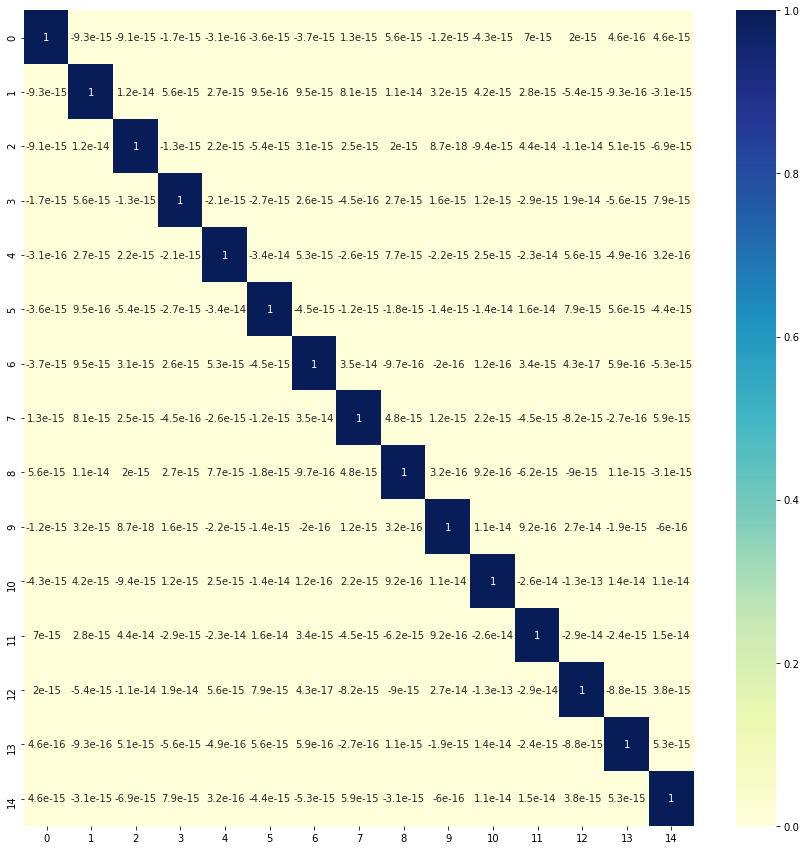

In [ ]:
plt.figure(figsize=[15,15])
sns.heatmap(corrmat, annot=True,cmap = 'YlGnBu')
plt.show()

In [ ]:
X_test = X_test[X_train_pca.columns]

In [ ]:
df_test_pca = pca_final.transform(X_test)
df_test_pca.shape

(8799, 15)

In [ ]:
df_train_pca

array([[ 8.91354396e-01,  3.76225373e-01,  1.06298790e-01, ...,
        -3.22059667e-03,  2.38814252e-03, -5.20421714e-03],
       [-1.17266211e-01, -5.20079445e-01,  3.19734204e-01, ...,
         2.84184597e-03, -2.46396944e-04,  3.14841106e-03],
       [ 7.95444406e-01,  1.89427349e-01,  2.31582716e-01, ...,
        -4.37956250e-03,  1.80952426e-03, -6.91203840e-03],
       ...,
       [-1.34738380e-01, -5.27755022e-01,  2.90101650e-01, ...,
         3.27160150e-03, -2.16562630e-03,  6.04636376e-03],
       [-1.12633160e-01, -9.99704598e-02, -3.05027984e-01, ...,
         3.19185115e-03, -8.92436140e-04,  4.30653549e-04],
       [-6.27759657e-02, -1.30635753e-01, -3.85399186e-01, ...,
        -5.78988951e-03,  2.49242281e-03, -6.78146408e-03]])

In [ ]:
components = pd.DataFrame({'PC1':pca_final.components_[0],'PC2':pca_final.components_[1],'Feature':X_train_pca.columns })
components

,PC1,PC2,Feature
0,-0.004461,-0.006012,num_hrefs
1,-0.002624,0.002126,num_self_hrefs
2,-0.018352,0.005569,num_imgs
3,0.016523,-0.009825,average_token_length
4,-0.481806,0.660843,data_channel_is_entertainment
5,0.665315,0.328278,data_channel_is_bus
6,-0.000049,-0.000204,kw_max_min
7,0.060956,0.033967,kw_avg_max
8,-0.000197,0.001363,kw_max_avg
9,-0.001169,0.006731,kw_avg_avg


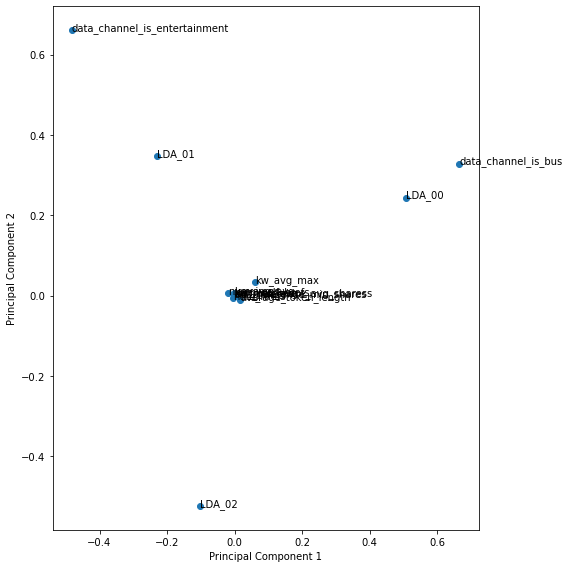

In [ ]:
%matplotlib inline
fig = plt.figure(figsize = (8,8))
plt.scatter(components.PC1, components.PC2)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
for i, txt in enumerate(components.Feature):
    plt.annotate(txt, (components.PC1[i],components.PC2[i]))
plt.tight_layout()
plt.show()

## Applying Linear Regression on the data with PCA

In [ ]:
linear_PCA = LinearRegression()

In [ ]:
model_pca = linear_PCA.fit(df_train_pca,y_train)

In [ ]:
# Evaluating Model
y_pred_pca = model_pca.predict(df_train_pca)

In [ ]:
y_pred_train = model_pca.predict(df_train_pca)
y_pred_test = model_pca.predict(df_test_pca)

metric = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric.append(rss2_lr)

rmse_train_lr = math.sqrt(mean_squared_error(y_train,y_pred_train))
print(rmse_train_lr)
metric.append(rmse_train_lr)

rmse_test_lr = math.sqrt(mean_squared_error(y_test,y_pred_test))
print(rmse_test_lr)
metric.append(rmse_test_lr)

0.0585977369732531
0.06340450234129769
319.4735272678012
140.66029738444618
0.12474798547301393
0.12643552225152208


In [ ]:
# Residual error
res = y_train-y_pred_train
res

5414    -0.017049
20493   -0.036751
9288    -0.030616
11522   -0.019640
9428    -0.047644
22019   -0.043819
6642    -0.028657
18635   -0.022283
13291   -0.070538
18336    0.035729
24172   -0.062016
24574   -0.055263
6364    -0.017390
20317    0.364699
25040    0.537514
19654   -0.029223
21657   -0.023796
29426   -0.035460
22314   -0.021870
29651   -0.029852
24953    0.269165
22874   -0.037132
368     -0.067458
25476   -0.038091
13243   -0.004647
2948     0.148034
15511   -0.047692
2226    -0.059243
27496   -0.021759
6971    -0.030582
6502    -0.035389
28917   -0.055225
12529   -0.080902
14789    0.144317
4195     0.094957
8055    -0.009672
22614   -0.019038
16576   -0.042443
19317    0.070227
17485   -0.033200
17482   -0.042976
19873   -0.052646
25328   -0.058050
6856    -0.021894
1547     0.109663
20883   -0.087723
19695   -0.030314
21720    0.014028
2209    -0.020096
3541    -0.059460
24185    0.036997
19123   -0.075889
25597   -0.035538
12319    0.129872
18769   -0.064849
3419    -0

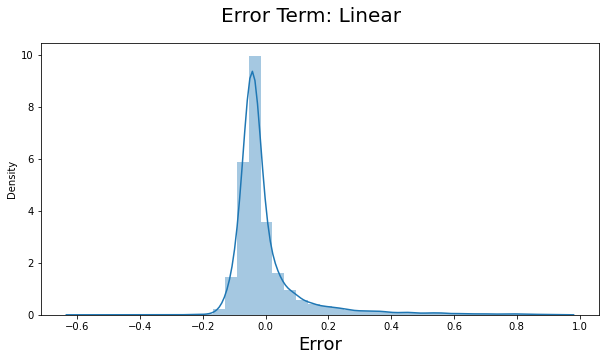

In [ ]:
# Visual representation of error terms
plt.figure(figsize = (10,5))
sns.distplot(res,bins = 40)
plt.suptitle('Error Term: Linear',fontsize = 20)
plt.xlabel('Error', fontsize = 18)
plt.show()

The plot for the Residual is almost uniformly distributed. Let's perform regression by using Lasso and Ridge for a better conclusion.

## Ridge Regression

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

In [ ]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low,
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1,
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge,
                        param_grid = params,
                        scoring= 'neg_root_mean_squared_error',
                        cv = folds,
                        return_train_score=True,
                        verbose = 1)
model_cv.fit(df_train_pca, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    1.2s finished


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_root_mean_squared_error',
             verbose=1)

In [ ]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 0.1}


In [ ]:
#Fitting Ridge model for alpha = 50 and printing coefficients which have been penalised
alpha = 1.0
ridge = Ridge(alpha=alpha)

ridge.fit(df_train_pca, y_train)
print(ridge.coef_)

[ 6.10252741e-04 -4.91040522e-04 -7.72655389e-02 -1.45848639e-02
  1.37008838e-02  4.10942314e-02  8.69714210e-04  1.47840739e-01
 -3.10850748e-02  3.65444222e-01  1.90185192e-01 -2.13983972e-02
 -2.96118335e-01  3.04378846e-01 -7.68586613e-01]


In [ ]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train = ridge.predict(df_train_pca)
y_pred_test = ridge.predict(df_test_pca)

metric2 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric2.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric2.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric2.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric2.append(rss2_lr)

rmse_train_lr = mean_squared_error(y_train, y_pred_train)
print(rmse_train_lr)
metric2.append(rmse_train_lr)

rmse_test_lr = mean_squared_error(y_test, y_pred_test)
print(rmse_test_lr)
metric2.append(rmse_test_lr)

0.05720348696777011
0.0625478708229944
319.9466788467157
140.7889484877396
0.015585107839968616
0.016000562392060415


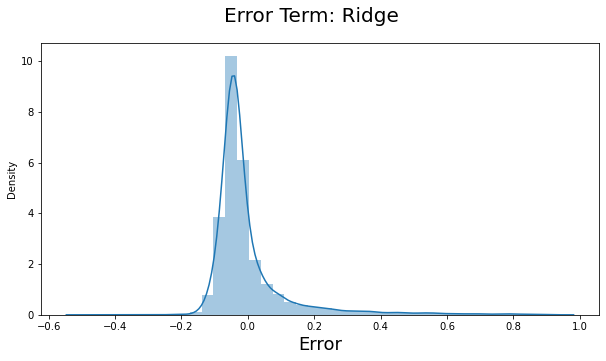

In [ ]:
# Residual error
res = y_train-y_pred_train
# Visual representation of error terms
plt.figure(figsize = (10,5))
sns.distplot(res,bins = 40)
plt.suptitle('Error Term: Ridge',fontsize = 20)
plt.xlabel('Error', fontsize = 18)
plt.show()

## Lasso

In [ ]:
from sklearn.linear_model import Lasso

In [ ]:
lasso = Lasso()

# cross validation
model_cv = GridSearchCV(estimator = lasso,
                        param_grid = params,
                        scoring= 'neg_root_mean_squared_error',
                        cv = folds,
                        return_train_score=True,
                        verbose = 1)

model_cv.fit(df_train_pca, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    1.9s finished


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_root_mean_squared_error',
             verbose=1)

In [ ]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 0.0001}


In [ ]:
#Fitting Ridge model for alpha = 50 and printing coefficients which have been penalised

alpha = 0.0001

lasso = Lasso(alpha=alpha)

lasso.fit(df_train_pca, y_train)

Lasso(alpha=0.0001)

In [ ]:
lasso.coef_

array([ 1.68553968e-04, -0.00000000e+00, -7.59362824e-02, -1.14433297e-02,
        9.96439915e-03,  3.61834863e-02,  0.00000000e+00,  1.28211915e-01,
       -0.00000000e+00,  2.99312248e-01,  9.27310559e-02, -0.00000000e+00,
       -0.00000000e+00,  0.00000000e+00, -0.00000000e+00])

In [ ]:
# Lets calculate some metrics such as R2 score, RSS and RMSE

y_pred_train = lasso.predict(df_train_pca)
y_pred_test = lasso.predict(df_test_pca)

metric3 = []
r2_train_lr = r2_score(y_train, y_pred_train)
print(r2_train_lr)
metric3.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print(r2_test_lr)
metric3.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print(rss1_lr)
metric3.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print(rss2_lr)
metric3.append(rss2_lr)

rmse_train_lr = mean_squared_error(y_train, y_pred_train)
print(rmse_train_lr)
metric3.append(rmse_train_lr)

rmse_test_lr = mean_squared_error(y_test, y_pred_test)
print(rmse_test_lr)
metric3.append(rmse_test_lr)

0.04707896779079457
0.05314457429945352
323.3825276654337
142.201159510216
0.015752473460248124
0.016161059155610412


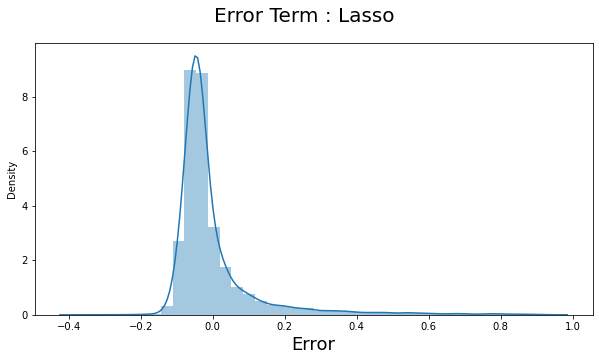

In [ ]:
# Residual error
res = y_train-y_pred_train
# Visual representation of error terms
plt.figure(figsize = (10,5))
sns.distplot(res,bins = 40)
plt.suptitle('Error Term : Lasso',fontsize = 20)
plt.xlabel('Error', fontsize = 18)
plt.show()

In [ ]:
# Creating a table which contain all the metrics

lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'RMSE (Train)','RMSE (Test)'],
        'Linear Regression': metric
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Linear Regression'] )

rg_metric = pd.Series(metric2, name = 'Ridge Regression')
ls_metric = pd.Series(metric3, name = 'Lasso Regression')

final_metric = pd.concat([lr_metric, rg_metric, ls_metric], axis = 1)

final_metric

,Metric,Linear Regression,Ridge Regression,Lasso Regression
0,R2 Score (Train),0.058598,0.057203,0.047079
1,R2 Score (Test),0.063405,0.062548,0.053145
2,RSS (Train),319.473527,319.946679,323.382528
3,RSS (Test),140.660297,140.788948,142.201160
4,RMSE (Train),0.124748,0.015585,0.015752
5,RMSE (Test),0.126436,0.016001,0.016161


By comparing the above results by three methods, we find results by Lasso and Ridge are almost similar and beat the results by Linear Regression.

One obvious advantage of Lasso regression over Ridge regression, is that it produces simpler and more interpretable models that incorporate only a reduced set of the predictors. However, neither ridge regression nor the lasso will universally dominate the other.

**We're going with model with Lasso Regression**

## 7. Feature Importance

In [ ]:
X_train_pca.head()

,num_hrefs,num_self_hrefs,num_imgs,average_token_length,data_channel_is_entertainment,data_channel_is_bus,kw_max_min,kw_avg_max,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_avg_sharess,LDA_00,LDA_01,LDA_02
5414,0.046784,0.025862,0.007812,0.538177,0.0,1.0,0.006702,0.135195,0.019705,0.069175,0.000964,0.000964,0.642659,0.114469,0.002024
20493,0.134503,0.017241,0.039062,0.627811,0.0,0.0,0.000000,0.501759,0.011452,0.061165,0.000875,0.001090,0.053351,0.053765,0.793001
9288,0.000000,0.000000,0.007812,0.564791,0.0,1.0,0.002433,0.285624,0.011644,0.065953,0.000000,0.000000,0.431297,0.016803,0.205144
11522,0.005848,0.025862,0.164062,0.617579,0.0,0.0,0.001659,0.441994,0.011423,0.048598,0.000000,0.000000,0.016672,0.016802,0.940859
9428,0.029240,0.043103,0.117188,0.519649,0.0,0.0,0.003070,0.181074,0.011075,0.034406,0.002372,0.002609,0.024028,0.024218,0.024207


## 8. Predicting on Unseen Data

In [ ]:
unseen = pd.read_csv(path+'test.csv')
unseen.head()

,id,url,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity
0,29733,http://mashable.com/2014/12/05/2014-cant-unsee/,10.0,564.0,0.505618,1.0,0.637394,21.0,1.0,0.0,3.0,4.723404,5.0,0.0,0.0,0.0,0.0,0.0,1.0,-1.0,442.0,128.000000,23700.0,843300.0,340780.000000,2154.061235,3702.951220,2994.958581,2300.0,2300.0,2300.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.040000,0.040069,0.839887,0.040038,0.040006,0.442277,0.053681,0.037234,0.019504,0.65625,0.343750,0.269218,0.062500,0.6,-0.263636,-0.700000,-0.10,1.0,0.0,0.5,0.0
1,29734,http://mashable.com/2014/01/02/twitter-new-yea...,12.0,1127.0,0.431298,1.0,0.621622,10.0,6.0,11.0,0.0,4.360248,8.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,733.0,254.875000,6300.0,843300.0,140325.000000,1671.078652,4040.166667,2704.175559,3500.0,6300.0,4900.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.025053,0.025040,0.025003,0.025000,0.899904,0.425115,0.159958,0.042591,0.014197,0.75000,0.250000,0.420924,0.033333,1.0,-0.243341,-0.714286,NaN,0.0,0.0,0.5,0.0
2,29735,http://mashable.com/2014/06/11/gopro-value-3-b...,10.0,400.0,0.564232,1.0,0.698795,1.0,0.0,1.0,1.0,4.765000,7.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.0,784.0,283.285714,6800.0,843300.0,166071.428571,1828.500000,3575.518291,2645.535689,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.028572,0.885666,0.028572,0.028620,0.028572,0.548466,0.011693,0.047500,0.032500,0.59375,0.406250,0.312286,0.136364,0.5,-0.354808,-0.800000,-0.15,0.0,0.0,0.5,0.0
3,29736,http://mashable.com/2014/10/08/spanish-ebola-d...,12.0,798.0,0.435279,1.0,0.613054,2.0,2.0,3.0,1.0,3.984962,9.0,0.0,1.0,0.0,0.0,0.0,0.0,-1.0,796.0,284.222222,1800.0,843300.0,325322.222222,1059.333333,7735.494465,3966.507513,6300.0,6300.0,6300.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.022223,0.495422,0.022223,0.437909,0.022223,0.537687,0.028463,0.047619,0.033835,NaN,0.415385,0.359650,0.136364,1.0,-0.362912,-1.000000,-0.05,0.0,0.0,0.5,0.0
4,29737,http://mashable.com/2014/02/09/jennifer-lawren...,11.0,1010.0,0.464503,1.0,0.611727,32.0,2.0,1.0,0.0,5.180198,8.0,0.0,0.0,0.0,0.0,0.0,1.0,-1.0,269.0,91.714286,0.0,843300.0,214137.500000,0.000000,3583.632001,2030.692327,1500.0,NaN,1500.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.025536,0.025047,0.899314,0.025101,0.025002,0.412513,0.104127,0.025743,0.013861,0.65000,0.350000,0.375991,0.100000,0.8,-0.264286,-0.500000,NaN,0.0,0.0,0.5,0.0


In [ ]:
submission_data = unseen.set_index('id')[X_train_pca.columns]
submission_data.shape

(9911, 15)

In [ ]:
round(100*(submission_data.isnull().sum()/submission_data.shape[0]),2)

num_hrefs                         2.76
num_self_hrefs                   16.17
num_imgs                         18.75
average_token_length              0.00
data_channel_is_entertainment     0.00
data_channel_is_bus               0.00
kw_max_min                        1.37
kw_avg_max                        0.34
kw_max_avg                        2.27
kw_avg_avg                        2.95
self_reference_min_shares         1.07
self_reference_avg_sharess        1.03
LDA_00                            0.00
LDA_01                            0.00
LDA_02                            0.00
dtype: float64

In [ ]:
cat_vars = []
for i in submission_data.columns:
    if submission_data[i].nunique() <3:
        cat_vars.append(i)
cat_vars

['data_channel_is_entertainment', 'data_channel_is_bus']

In [ ]:
num_vars = []
for i in submission_data.columns:
    if submission_data[i].nunique()>2:
        num_vars.append(i)
num_vars

['num_hrefs',
 'num_self_hrefs',
 'num_imgs',
 'average_token_length',
 'kw_max_min',
 'kw_avg_max',
 'kw_max_avg',
 'kw_avg_avg',
 'self_reference_min_shares',
 'self_reference_avg_sharess',
 'LDA_00',
 'LDA_01',
 'LDA_02']

In [ ]:
for i in submission_data[cat_vars].columns:
    if submission_data[i].isnull().sum()!=0:
        I = submission_data[i].mode()
        submission_data[i] = submission_data[i].fillna(value = I.iloc[0])
submission_data[cat_vars].isnull().sum()

data_channel_is_entertainment    0
data_channel_is_bus              0
dtype: int64

In [ ]:
for i in submission_data[num_vars].columns:
    if submission_data[i].isnull().sum()!=0:
        I = submission_data[i].median()
        submission_data[i] = submission_data[i].fillna(value = I)
submission_data[num_vars].isnull().sum()

num_hrefs                     0
num_self_hrefs                0
num_imgs                      0
average_token_length          0
kw_max_min                    0
kw_avg_max                    0
kw_max_avg                    0
kw_avg_avg                    0
self_reference_min_shares     0
self_reference_avg_sharess    0
LDA_00                        0
LDA_01                        0
LDA_02                        0
dtype: int64

In [ ]:
submission_data = pca_final.transform(submission_data)
submission_data.shape

(9911, 15)

In [ ]:
unseen['Shares'] = lasso.predict(submission_data)
output_l = unseen[['id','Shares']]
output_l['Shares'] = output_l['Shares'].round(2)
output_l.head()

,id,Shares
0,29733,-14718.297680
1,29734,-5812.569719
2,29735,-7563.468152
3,29736,-15387.009723
4,29737,-10150.825944


In [ ]:
output_l.to_csv(path+'submission_lasso.csv',index=False)

## 9. Lets observe the changes in the coefficients after regularization

In [ ]:
betas = pd.DataFrame(index=X_train_pca.columns)
betas.rows = X_train_pca.columns

In [ ]:
betas['Linear'] = model_pca.coef_
betas['Ridge'] = ridge.coef_
betas['Lasso'] = lasso.coef_

In [ ]:
pd.set_option('display.max_rows', None)
betas

,Linear,Ridge,Lasso
num_hrefs,0.000610,0.000610,0.000169
num_self_hrefs,-0.000491,-0.000491,-0.000000
num_imgs,-0.077318,-0.077266,-0.075936
average_token_length,-0.014607,-0.014585,-0.011443
data_channel_is_entertainment,0.013726,0.013701,0.009964
data_channel_is_bus,0.041195,0.041094,0.036183
kw_max_min,0.000874,0.000870,0.000000
kw_avg_max,0.149364,0.147841,0.128212
kw_max_avg,-0.031681,-0.031085,-0.000000
kw_avg_avg,0.379766,0.365444,0.299312
